In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm

<div>
<img src="door.png" width="500" align="left"/>
</div>

Write a program in that implements a particle filter to estimate the state $\boldsymbol{x}_t$ of the robot from a sequence $\boldsymbol{u}_1, \boldsymbol{z}_1, \boldsymbol{u}_2, \boldsymbol{z}_2, \ldots, \boldsymbol{u}_t, \boldsymbol{z}_t$ of odometry commands and sensor measurements.
- The robot is equipped with a sensor that measures the distance to the nearest door in the corridor. Each sensor measurement is a single range reading $z_t$ that corresponds to the distance to the nearest door (either forwards or backwards). Every reading is corrupted only with Gaussian noise $\mathcal{N}\left(\mu, \sigma^2\right)$ with $\mu=0$ and $\sigma=0.5 \mathrm{~m}$.
- The robot is also equipped with wheel encoders that produce discrete-time odometry measurements $\boldsymbol{u}_t=\delta_{\text {trans }}$. Here too, every measurement is corrupted with Gaussian noise $\mathcal{N}\left(\mu, \sigma^2\right)$ with $\mu=0$ and $\sigma=2 \mathrm{~m}$. (This motion model is the same motion model presented in lecture but without the rotational components and in the $x$ dimension only.)

Use your implementation of the particle filter on the following data. The map is the one illustrated in the figure. The length of the corridor is 100 meters. There are three doors at the following positions: 20.0, 40.0, and 80.0 meters.

You have no prior knowledge about the position of the robot at first. Then, you obtain the following odometry commands and observation pairs:
1. $\boldsymbol{u}_1=10 \mathrm{~m}, \boldsymbol{z}_1=10 \mathrm{~m}$
2. $\boldsymbol{u}_2=20 \mathrm{~m}, \boldsymbol{z}_2=10 \mathrm{~m}$
2. $\boldsymbol{u}_3=20 \mathrm{~m}, \boldsymbol{z}_3=10 \mathrm{~m}$
2. $\boldsymbol{u}_4=10 \mathrm{~m}, \boldsymbol{z}_4=20 \mathrm{~m}$

### Implementation of Particle Filter (PF):

The implementation of the PF in Python is provided in a class called ParticleFilter. The class has several methods to initialize and run the filter.

### Initialization:

The constructor of the ParticleFilter class initializes the parameters required for the filter. These parameters are:

space: The range of the world in which the robot moves.

map: The locations of the landmarks in the world.

sens_sig: The standard deviation of the sensor noise.

odom_sig: The standard deviation of the odometry noise.

N: The number of particles used in the filter.

The class also initializes the state of the filter. It creates an array of N particles called X_t, which represents the possible positions of the robot in the world. It also creates an array of N weights called W_t, which represent the likelihood of each particle being the true position of the robot.

### Method 1: initialize_particles()

The initialize_particles() method is called to randomly initialize the position of the particles in the world. It generates N random numbers in the range of [0,100] and assigns them to X_t. It also sets the initial weights of the particles to 1/N.

### Method 2: sample_pose()

The sample_pose() method is used to predict the new pose of the robot based on its previous pose and the control input. The method takes two arguments:

x_tm1: The previous pose of the robot.

u_t: The control input.

The method adds the previous pose x_tm1 to the control input u_t and adds some random noise sampled from a normal distribution with zero mean and standard deviation odom_sig. It also ensures that the new pose is within the range of the world using the clip() method. The method returns the new pose x_t.

### Method 3: likelihood_of_z_given_x()

The likelihood_of_z_given_x() method is used to calculate the likelihood of a sensor measurement given a particle. The method takes two arguments:

z_t: The sensor measurement.

x_t: The particle.

The method finds the closest landmark to the particle and calculates the distance between the landmark and the particle. It then calculates the expected distance between the robot and the landmark and uses this to calculate the likelihood of the sensor measurement using the normal distribution with mean z_hat and standard deviation sens_sig. The method returns the likelihood p.

### Method 4: iterate_pf()

The iterate_pf() method is used to update the state of the filter using the sensor measurements and control inputs. The method takes two arguments:

u_t: The control input.

z_t: The sensor measurement.

The method iterates over each particle and updates its position using the sample_pose() method. It also updates the weight of the particle using the likelihood_of_z_given_x() method. The method normalizes the weights by dividing them by the sum of all weights. It then calls the resample() method to resample the particles based on their weights.

### Method 5: resample()

The resample() method is used to resample the particles based on their weights.

In [27]:
class ParticleFilter:
    def __init__(self, space=[0,100], map=[20,40,80], sens_sig=0.5, odom_sig=2, N=250):
        self.space = space
        self.map = map
        self.sens_sig = sens_sig
        self.odom_sig = odom_sig
        self.N = N
        self.X_t = np.zeros(N)
        self.W_t = np.ones(N)/N

    # Uniformly distribute particles
    def initialize_particles(self):
        ## initialize the particles with uniform distributions.
        # N samples
        self.X_t = np.random.uniform(self.space[0], self.space[1], size=self.N)
        # Equal weights
        self.W_t = np.ones(self.N)/self.N

    # Next pose of a particle
    def sample_pose(self, x_tm1, u_t):
        ## sample the particles based on the odometry models and noise distributions.
        # Sample of noise
        x_t = x_tm1 + u_t + np.random.normal(0, self.odom_sig)
        # Clip at boundaries
        x_t = np.clip(x_t, self.space[0], self.space[1])
        return x_t

    def likelihood_of_z_given_x(self, z_t, x_t):
        # Which door is nearest
        i = np.argmin(np.abs(self.map - x_t))
        # Location of nearest door
        door_loc = self.map[i]
        # Distance
        z_hat = abs(door_loc - x_t)
        # Probability of measurement given distance
        p = norm.pdf(z_t, loc=z_hat, scale=self.sens_sig)
        return p

    def iterate_pf(self, u_t, z_t):
        ## for each particle
        for i in range(self.N):
            ## update the position based on motion model
            self.X_t[i] = self.sample_pose(self.X_t[i], u_t)
            ## update the weights based on measurement
            self.W_t[i] = self.W_t[i] * self.likelihood_of_z_given_x(z_t, self.X_t[i])
        w_tot = np.sum(self.W_t)
        self.W_t /= w_tot ## normalize the weights so they sum to 1
        self.resample()

    def resample(self):
        M = len(self.W_t)
        Minv = 1/M
        X_t_bar = np.zeros(M)
        W_t_bar = np.ones(M)*Minv
        # r is a random offset so sampling is not deterministic
        r = np.random.uniform(0, Minv)
        # print("r:", r)
        c = self.W_t[0]
        i = 0
        # For each particle
        for m in range(M):
            U = r + m*Minv
            # print("U:", U)
            # Skip over particles until c >= U
            while U > c:
                i += 1
                c += self.W_t[i]
            # Add current particle
            X_t_bar[m] = self.X_t[i]
            # print("Added particle", i, " c ==", c)
        self.X_t = X_t_bar
        self.W_t = W_t_bar

    def plot_particles(self, title_str):
        fig, axs = plt.subplots(2, 1)
        axs[0].scatter(self.X_t, np.zeros(self.N), color='blue')
        axs[0].set_xlim(self.space)
        axs[0].set_xlabel('$x_t$ (m)')
        for i in range(len(self.map)):
            axs[0].axvline(x=self.map[i])
        axs[0].set_title(title_str)
        axs[1].hist(self.X_t, bins=np.arange(0, 101))
        axs[1].set_xlabel('$x_t$ (m)')
        axs[1].set_ylabel('Count')
        plt.tight_layout()
        plt.show()

    def run(self):
        self.initialize_particles()
        self.plot_particles('Initial Particles')
        self.iterate_pf(10, 10)
        self.plot_particles('Particles after $u_1=10$, $z_1=10$')
        self.iterate_pf(20, 10)
        self.plot_particles('Particles after $u_2=20$, $z_2=10$')
        self.iterate_pf(20, 10)
        self.plot_particles('Particles after $u_3=20$, $z_3=10$')
        self.iterate_pf(-10, 20)
        self.plot_particles('Particles after $u_4=-10$, $z_4=20$')


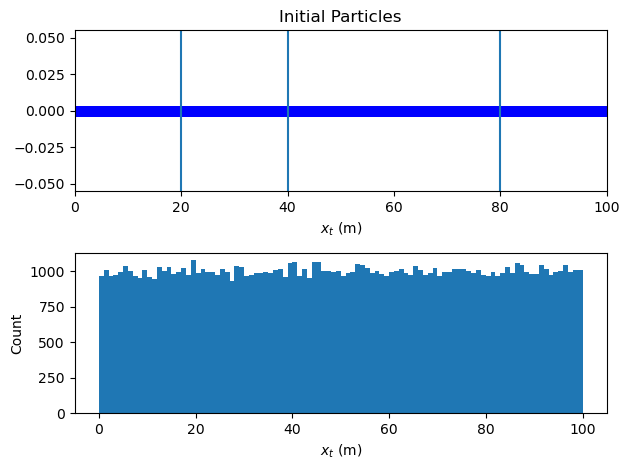

r: 4.0691033375749264e-06
U: 4.0691033375749264e-06
Added particle 2  c == 0.00011675714635357114
U: 1.4069103337574927e-05
Added particle 2  c == 0.00011675714635357114
U: 2.406910333757493e-05
Added particle 2  c == 0.00011675714635357114
U: 3.406910333757493e-05
Added particle 2  c == 0.00011675714635357114
U: 4.406910333757493e-05
Added particle 2  c == 0.00011675714635357114
U: 5.406910333757493e-05
Added particle 2  c == 0.00011675714635357114
U: 6.406910333757493e-05
Added particle 2  c == 0.00011675714635357114
U: 7.406910333757493e-05
Added particle 2  c == 0.00011675714635357114
U: 8.406910333757493e-05
Added particle 2  c == 0.00011675714635357114
U: 9.406910333757493e-05
Added particle 2  c == 0.00011675714635357114
U: 0.00010406910333757493
Added particle 2  c == 0.00011675714635357114
U: 0.00011406910333757493
Added particle 2  c == 0.00011675714635357114
U: 0.00012406910333757494
Added particle 5  c == 0.0002054149183135706
U: 0.00013406910333757494
Added particle 5  c =

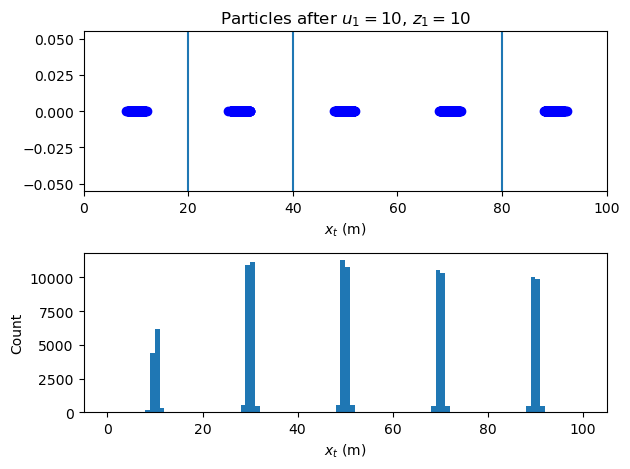

r: 2.6067091710637146e-07
U: 2.6067091710637146e-07
Added particle 2  c == 2.5129150552002952e-05
U: 1.0260670917106373e-05
Added particle 2  c == 2.5129150552002952e-05
U: 2.0260670917106372e-05
Added particle 2  c == 2.5129150552002952e-05
U: 3.0260670917106375e-05
Added particle 3  c == 7.201510009458523e-05
U: 4.0260670917106374e-05
Added particle 3  c == 7.201510009458523e-05
U: 5.026067091710637e-05
Added particle 3  c == 7.201510009458523e-05
U: 6.026067091710638e-05
Added particle 3  c == 7.201510009458523e-05
U: 7.026067091710638e-05
Added particle 3  c == 7.201510009458523e-05
U: 8.026067091710638e-05
Added particle 4  c == 0.00012032268366102721
U: 9.026067091710638e-05
Added particle 4  c == 0.00012032268366102721
U: 0.00010026067091710638
Added particle 4  c == 0.00012032268366102721
U: 0.00011026067091710638
Added particle 4  c == 0.00012032268366102721
U: 0.0001202606709171064
Added particle 4  c == 0.00012032268366102721
U: 0.0001302606709171064
Added particle 7  c == 0

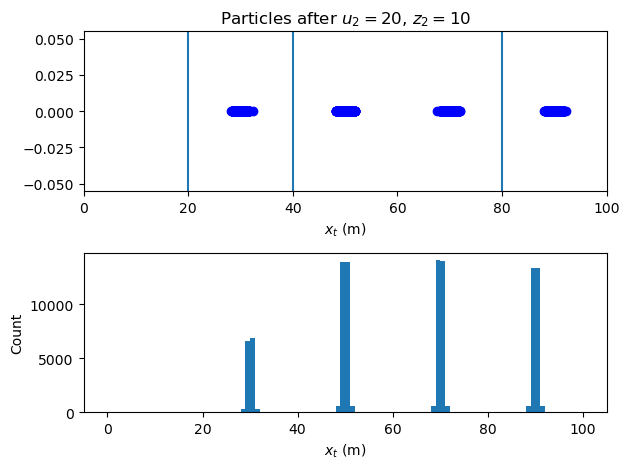

r: 6.407741981675799e-06
U: 6.407741981675799e-06
Added particle 23  c == 1.0948814488345969e-05
U: 1.64077419816758e-05
Added particle 24  c == 6.522764789386435e-05
U: 2.64077419816758e-05
Added particle 24  c == 6.522764789386435e-05
U: 3.64077419816758e-05
Added particle 24  c == 6.522764789386435e-05
U: 4.64077419816758e-05
Added particle 24  c == 6.522764789386435e-05
U: 5.64077419816758e-05
Added particle 24  c == 6.522764789386435e-05
U: 6.640774198167581e-05
Added particle 27  c == 7.633314997021149e-05
U: 7.640774198167581e-05
Added particle 28  c == 9.200648682083446e-05
U: 8.640774198167581e-05
Added particle 28  c == 9.200648682083446e-05
U: 9.640774198167581e-05
Added particle 29  c == 0.00014803802622709246
U: 0.00010640774198167581
Added particle 29  c == 0.00014803802622709246
U: 0.0001164077419816758
Added particle 29  c == 0.00014803802622709246
U: 0.00012640774198167582
Added particle 29  c == 0.00014803802622709246
U: 0.00013640774198167582
Added particle 29  c == 

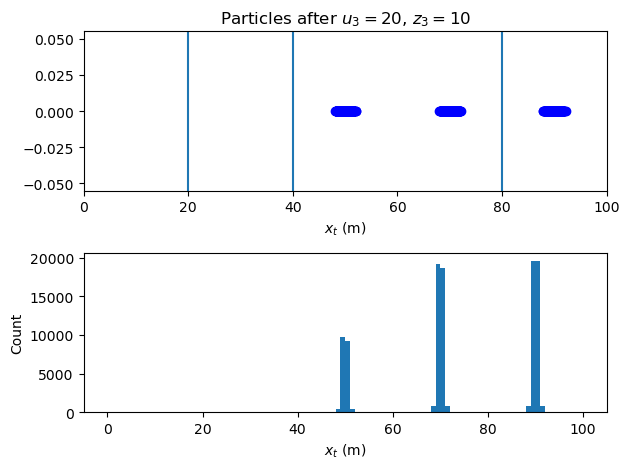

r: 8.198066448769024e-06
U: 8.198066448769024e-06
Added particle 62  c == 1.4531971632840383e-05
U: 1.8198066448769024e-05
Added particle 63  c == 0.0001181301846865246
U: 2.8198066448769023e-05
Added particle 63  c == 0.0001181301846865246
U: 3.819806644876903e-05
Added particle 63  c == 0.0001181301846865246
U: 4.819806644876903e-05
Added particle 63  c == 0.0001181301846865246
U: 5.819806644876903e-05
Added particle 63  c == 0.0001181301846865246
U: 6.819806644876903e-05
Added particle 63  c == 0.0001181301846865246
U: 7.819806644876903e-05
Added particle 63  c == 0.0001181301846865246
U: 8.819806644876902e-05
Added particle 63  c == 0.0001181301846865246
U: 9.819806644876902e-05
Added particle 63  c == 0.0001181301846865246
U: 0.00010819806644876902
Added particle 63  c == 0.0001181301846865246
U: 0.00011819806644876902
Added particle 64  c == 0.00014445569653608693
U: 0.00012819806644876904
Added particle 64  c == 0.00014445569653608693
U: 0.00013819806644876903
Added particle 64 

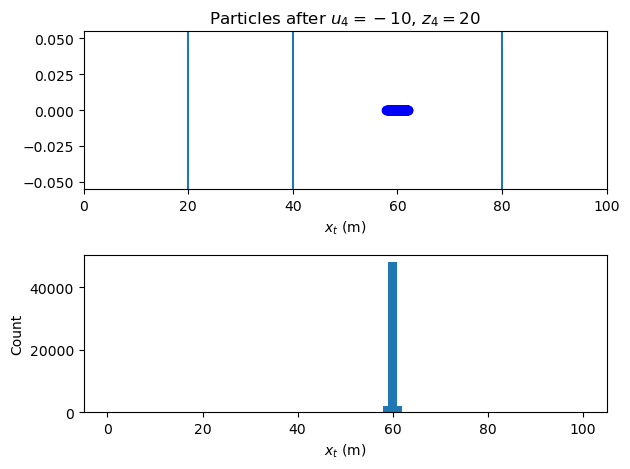

In [28]:
pf = ParticleFilter(N=100000)
pf.run()
